In [3]:
import os
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

import warnings
warnings.filterwarnings("ignore")

from scipy import stats
from scipy.stats import pearsonr

import ptitprince as pt

In [4]:
path = 'dataset.parquet'

df = pd.read_parquet(path)
df

,time,sample,anomaly,category,setting,action,active,robot_voltage,robot_current,io_current,...,torque_sensor_a_6,torque_sensor_b_6,motor_iq_6,motor_id_6,power_motor_el_6,power_motor_mech_6,power_load_mech_6,motor_voltage_6,supply_voltage_6,brake_voltage_6
0,0.000000,0,True,0,0,0,0,48.582687,0.322263,0.087890,...,0.069086,-0.066240,0.161936,-0.019600,0.115915,0.0,1.157006e-05,0.729223,47.783798,11.177029
1,0.010047,0,True,0,0,0,0,48.582687,0.527340,0.087890,...,0.055269,-0.063480,0.142992,0.020944,0.134123,0.0,-7.832955e-07,0.630203,47.783798,10.976003
2,0.020135,0,True,0,0,0,0,48.561890,0.380857,0.087890,...,0.060796,-0.080041,0.145380,0.011475,0.115405,0.0,4.344085e-07,0.620702,47.803898,11.217231
3,0.030203,0,True,0,0,0,0,48.582687,0.483395,0.087890,...,0.046979,-0.066240,0.147767,0.002005,0.097916,0.0,2.882664e-06,0.623614,47.783798,11.177029
4,0.040257,0,True,0,0,0,0,48.582687,0.307615,0.087890,...,0.046979,-0.074521,0.147767,0.002005,0.104346,0.0,6.304338e-07,0.499930,47.803898,11.156923
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2321685,10.716863,2121,False,12,76,13,1,48.561890,0.688472,0.087890,...,0.055269,-0.063480,0.133460,0.024379,0.103935,0.0,-1.502957e-05,0.595642,47.803898,11.217231
2321686,10.726921,2121,False,12,76,13,1,48.561890,0.644527,0.073242,...,0.041452,-0.044160,0.142870,0.021766,0.078053,0.0,7.213437e-07,0.517480,47.803898,10.976000
2321687,10.737022,2121,False,12,76,13,1,48.541092,0.908197,0.087890,...,0.066323,-0.049680,0.124408,-0.008216,0.080420,0.0,9.829410e-06,0.496470,47.783798,11.197131
2321688,10.747115,2121,False,12,76,13,1,48.582687,0.688472,0.117187,...,0.069086,-0.044160,0.124408,-0.008216,0.092157,0.0,7.721170e-06,0.817346,47.783798,11.116721


In [5]:
# Excluding ['time','sample','category','setting','action','active']
df = df.drop(['sample','category','setting','action','active'], axis=1)

# Converting the column 'anomaly' from boolean to int
df['anomaly'] = df['anomaly'].astype(int)

df

,time,anomaly,robot_voltage,robot_current,io_current,system_current,target_position_1,target_velocity_1,target_acceleration_1,target_torque_1,...,torque_sensor_a_6,torque_sensor_b_6,motor_iq_6,motor_id_6,power_motor_el_6,power_motor_mech_6,power_load_mech_6,motor_voltage_6,supply_voltage_6,brake_voltage_6
0,0.000000,1,48.582687,0.322263,0.087890,0.278318,-0.341433,-0.0,-0.0,0.127406,...,0.069086,-0.066240,0.161936,-0.019600,0.115915,0.0,1.157006e-05,0.729223,47.783798,11.177029
1,0.010047,1,48.582687,0.527340,0.087890,0.410153,-0.341433,-0.0,-0.0,0.314227,...,0.055269,-0.063480,0.142992,0.020944,0.134123,0.0,-7.832955e-07,0.630203,47.783798,10.976003
2,0.020135,1,48.561890,0.380857,0.087890,0.292967,-0.341433,-0.0,-0.0,0.002657,...,0.060796,-0.080041,0.145380,0.011475,0.115405,0.0,4.344085e-07,0.620702,47.803898,11.217231
3,0.030203,1,48.582687,0.483395,0.087890,0.263670,-0.341433,-0.0,-0.0,-0.128248,...,0.046979,-0.066240,0.147767,0.002005,0.097916,0.0,2.882664e-06,0.623614,47.783798,11.177029
4,0.040257,1,48.582687,0.307615,0.087890,0.263670,-0.341433,-0.0,-0.0,0.097738,...,0.046979,-0.074521,0.147767,0.002005,0.104346,0.0,6.304338e-07,0.499930,47.803898,11.156923
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2321685,10.716863,0,48.561890,0.688472,0.087890,0.263670,-0.341433,-0.0,-0.0,-1.652499,...,0.055269,-0.063480,0.133460,0.024379,0.103935,0.0,-1.502957e-05,0.595642,47.803898,11.217231
2321686,10.726921,0,48.561890,0.644527,0.073242,0.219725,-0.341433,-0.0,-0.0,-1.703043,...,0.041452,-0.044160,0.142870,0.021766,0.078053,0.0,7.213437e-07,0.517480,47.803898,10.976000
2321687,10.737022,0,48.541092,0.908197,0.087890,0.263670,-0.341433,-0.0,-0.0,-1.405120,...,0.066323,-0.049680,0.124408,-0.008216,0.080420,0.0,9.829410e-06,0.496470,47.783798,11.197131
2321688,10.747115,0,48.582687,0.688472,0.117187,0.278318,-0.341433,-0.0,-0.0,-1.668486,...,0.069086,-0.044160,0.124408,-0.008216,0.092157,0.0,7.721170e-06,0.817346,47.783798,11.116721


## EDA

In [81]:
# Print the number of missing values and the percentage of missing values for each column

df_mv = df.isnull().sum()
df_mv_percent = 100 * df.isnull().sum() / len(df)
df_mv_table = pd.concat([df_mv, df_mv_percent], axis=1)
df_mv_table = df_mv_table.rename(columns = {0 : 'Missing Values', 1 : '% of Total Values'})
df_mv_table = df_mv_table[df_mv_table.iloc[:,1] != 0].sort_values('% of Total Values', ascending=False).round(1)
print ("There are " + str(df_mv_table.shape[0]) + " columns that have missing values.")

There are 0 columns that have missing values.


In [83]:
df_mv_percent

anomaly               0.0
robot_voltage         0.0
robot_current         0.0
io_current            0.0
system_current        0.0
                     ... 
power_motor_mech_6    0.0
power_load_mech_6     0.0
motor_voltage_6       0.0
supply_voltage_6      0.0
brake_voltage_6       0.0
Length: 131, dtype: float64

In [82]:
# Print the number of duplicated rows

df_duplicated = df.duplicated().sum()
print('Number of duplicated rows:', df_duplicated)

Number of duplicated rows: 0


In [22]:
anomaly_counts = df['anomaly'].value_counts()
anomaly_counts

0    1488328
1     833362
Name: anomaly, dtype: int64

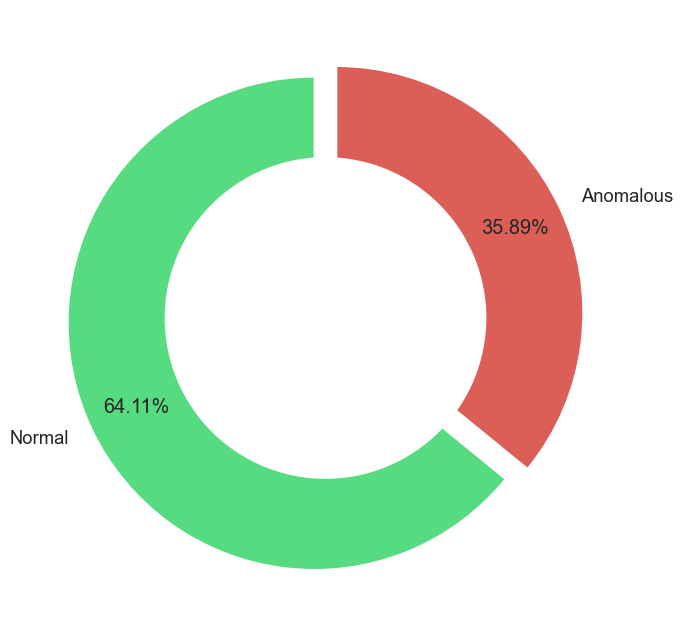

In [28]:
values = anomaly_counts.values
labels = ['Normal', 'Anomalous']

sns.set(font_scale=1.2)
plt.figure(figsize=(8, 8))

# Define the colors
colors = sns.color_palette("hls", 8)
red = colors[0]
green = colors[3]
colors_list = [green, red]

plt.pie(
    x= values, labels= labels,
    colors=colors_list,
    startangle=90,
    # show percentages
    autopct='%1.2f%%',
    # move the percentage inside the arcs
    pctdistance=0.80,
    # add space between the arcs
    explode=[0.05, 0.05]
)

### Add a hole in the pie
hole = plt.Circle((0, 0), 0.65, facecolor='white')
plt.gcf().gca().add_artist(hole)

plt.show()


In [88]:
normal_df = df[df['anomaly'] == 0]
anomaly_df = df[df['anomaly'] == 1]

In [89]:
print("Shape of Normal data", normal_df.shape)
print("Shape of Abnormal data", anomaly_df.shape)

Shape of Normal data (1488328, 131)
Shape of Abnormal data (833362, 131)


## Statistical relationships

In [6]:
def plot_relplot(df, predictor, save=True):
    data = df.copy()
    data['anomaly'] = data['anomaly'].apply(lambda x: 'Anomalous' if x == 1 else 'Normal')

    colors = sns.color_palette("hls", 8)
    red = colors[0]
    green = colors[3]
    colors_list = [red, green]
    title = predictor.replace('_', ' ').title()

    ax = sns.relplot(data=data,
                x='time',
                y=predictor,
                hue='anomaly',
                # kind='line',
                col_order=['Anomalous', 'Normal'],
                palette=colors_list,
                col='anomaly',
                legend=False,
                )
    ax.set_axis_labels("Timepoint", title, fontsize=10)
    ax.set_titles("{col_name}", fontsize=10)
    ax.fig.suptitle(title, fontsize=14)

    if save:
        if not os.path.exists('figures/relplot'):
            os.makedirs('figures/relplot')
        plt.savefig('figures/relplot/' + predictor + '.png', dpi=1200)

    plt.show()
    

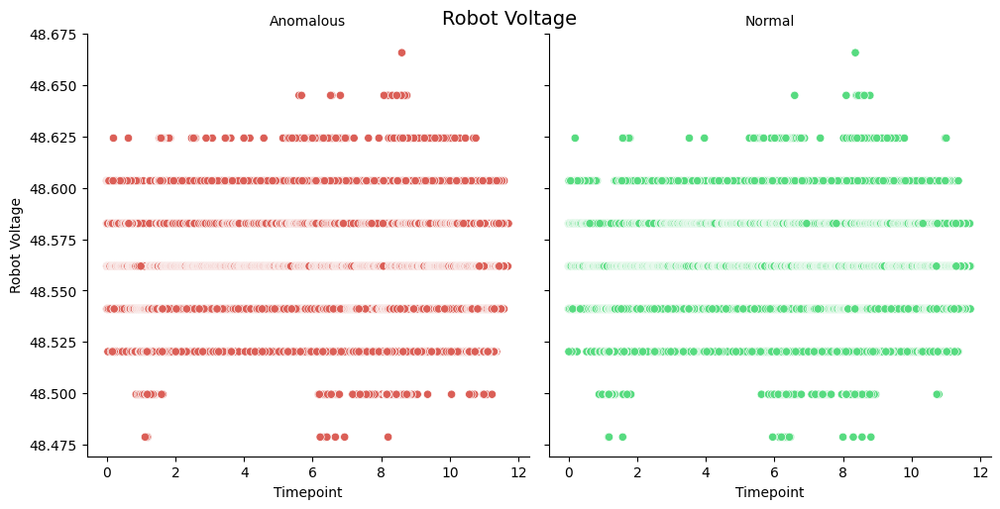

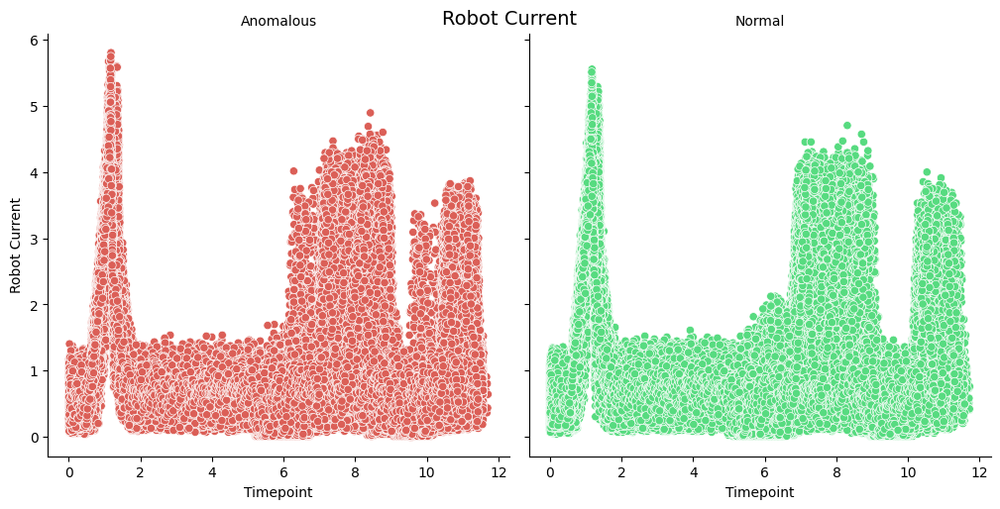

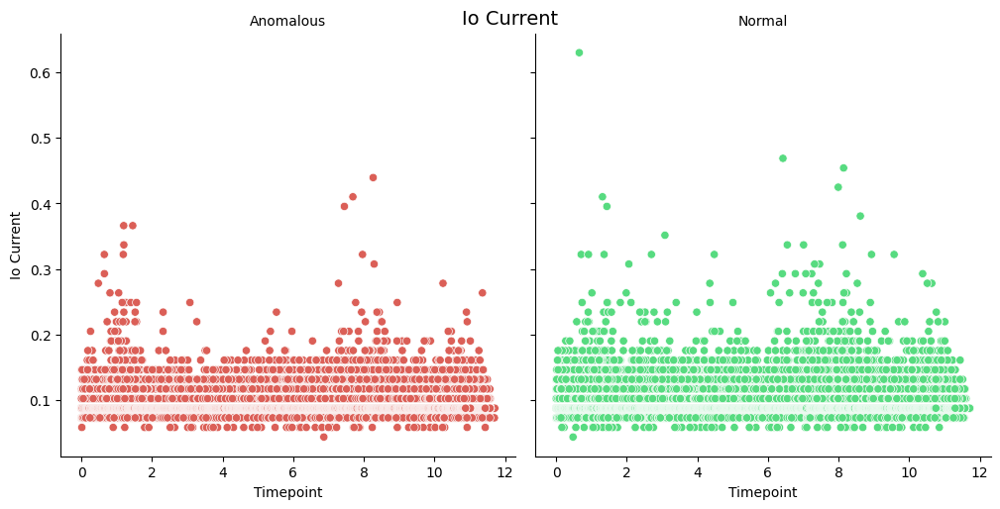

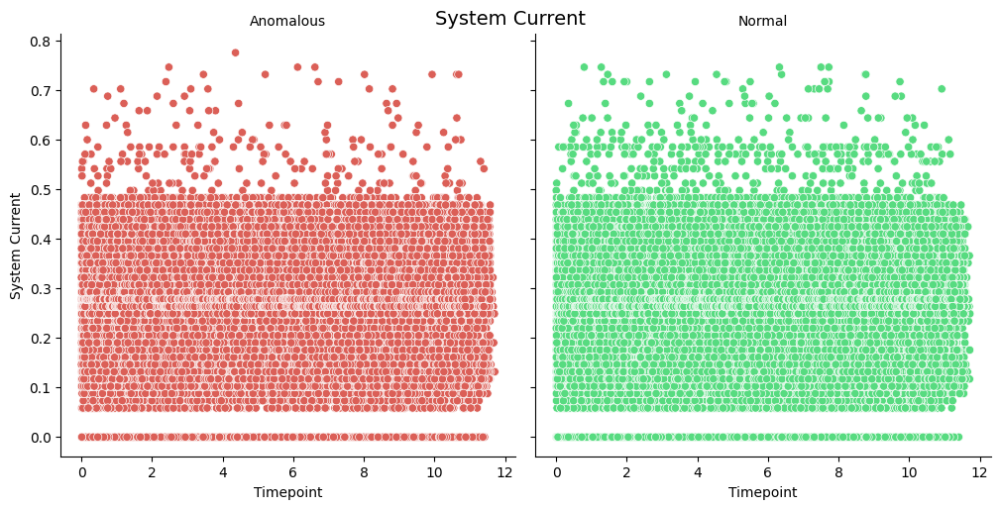

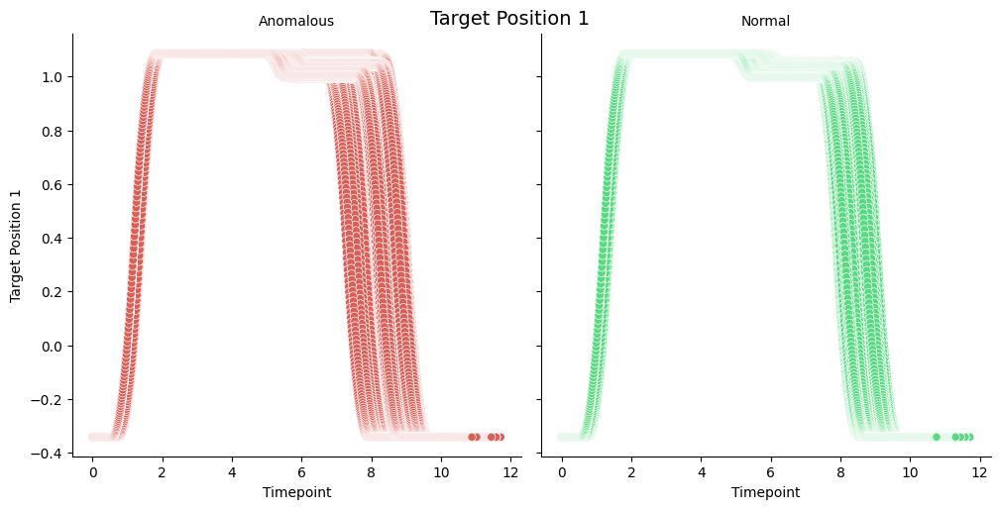

...

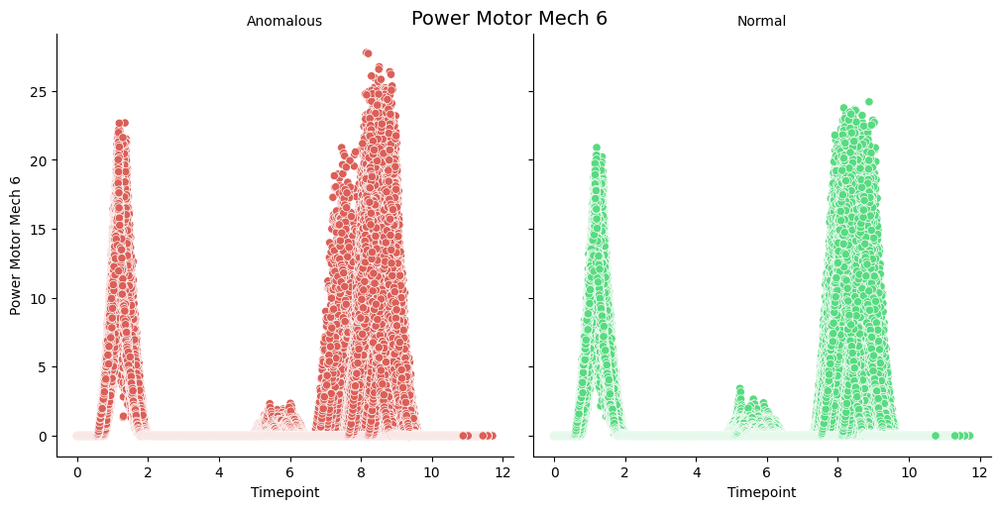

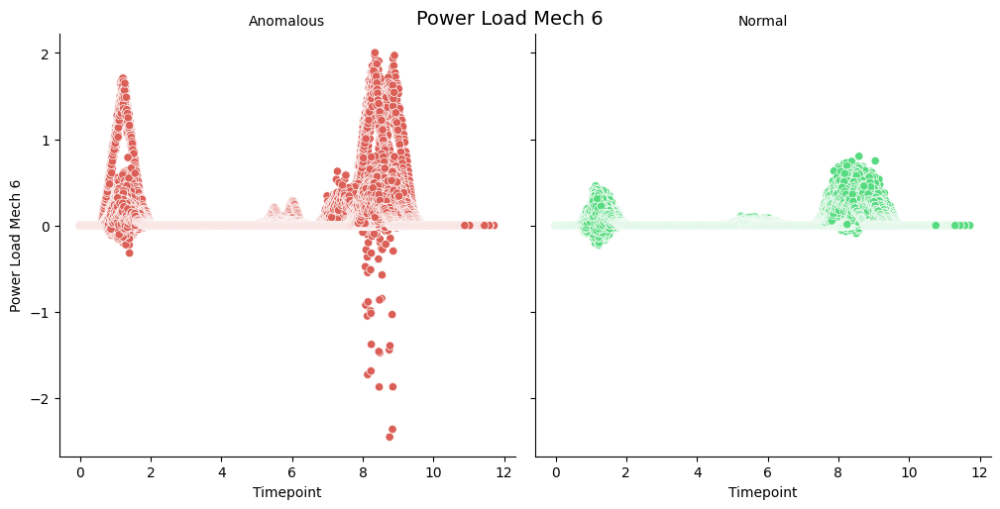

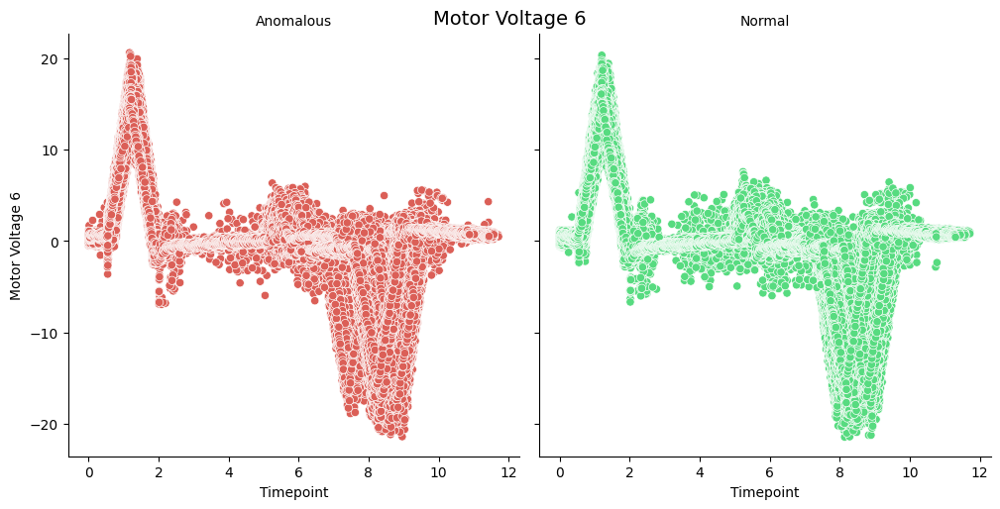

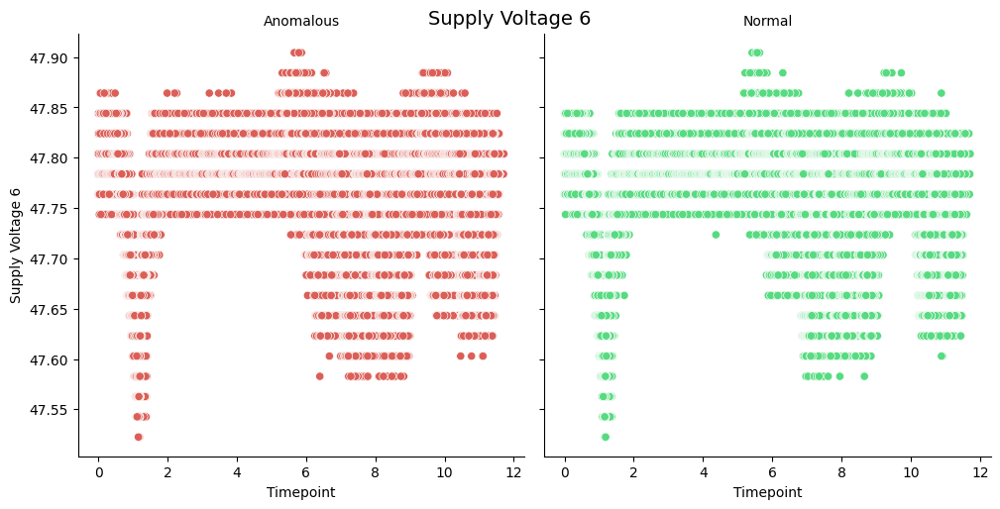

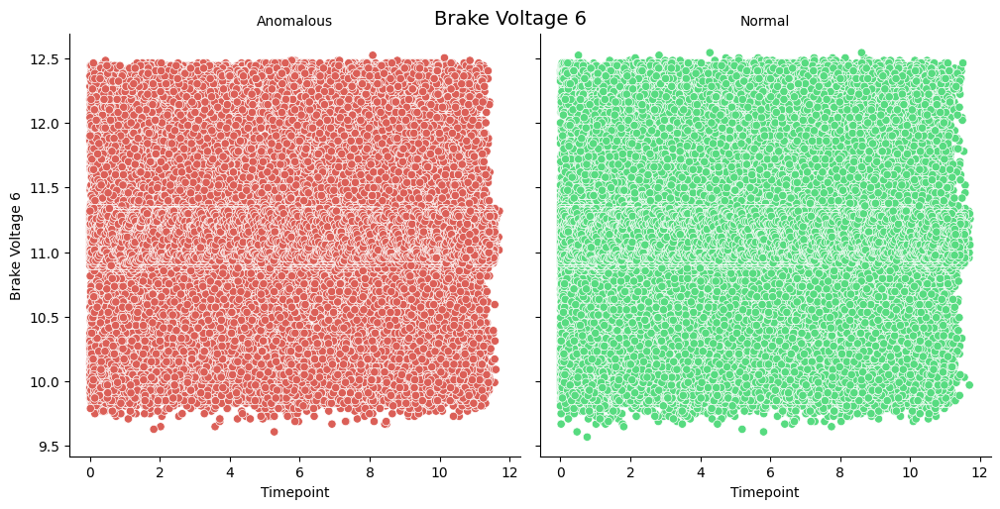

In [7]:
columns = df.columns.tolist()
columns.remove('anomaly')
columns.remove('time')

for column in columns:
    plot_relplot(df, column)